In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split,GridSearchCV,cross_val_score
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score,confusion_matrix,classification_report,roc_curve,roc_auc_score
from sklearn.ensemble import AdaBoostClassifier

from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier,GradientBoostingClassifier
from sklearn.svm import SVC

!pip install xgboost
from xgboost import XGBClassifier

plt.rcParams['figure.figsize']=(15,10)
plt.rcParams['figure.dpi']=300
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

In [ ]:
# Load The DataSet
df=pd.read_csv("/content/project-data.csv",delimiter=";")
df

,category,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
0,no_disease,32,m,38.5,52.5,7.7,22.1,7.5,6.93,3.23,106.0,12.1,69
1,no_disease,32,m,38.5,70.3,18.0,24.7,3.9,11.17,4.80,74.0,15.6,76.5
2,no_disease,32,m,46.9,74.7,36.2,52.6,6.1,8.84,5.20,86.0,33.2,79.3
3,no_disease,32,m,43.2,52.0,30.6,22.6,18.9,7.33,4.74,80.0,33.8,75.7
4,no_disease,32,m,39.2,74.1,32.6,24.8,9.6,9.15,4.32,76.0,29.9,68.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...
610,cirrhosis,62,f,32.0,416.6,5.9,110.3,50.0,5.57,6.30,55.7,650.9,68.5
611,cirrhosis,64,f,24.0,102.8,2.9,44.4,20.0,1.54,3.02,63.0,35.9,71.3
612,cirrhosis,64,f,29.0,87.3,3.5,99.0,48.0,1.66,3.63,66.7,64.2,82
613,cirrhosis,46,f,33.0,NaN,39.0,62.0,20.0,3.56,4.20,52.0,50.0,71


## **Exploratory Data Analysis**

In [ ]:
df.describe()

,age,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase
count,615.000000,614.000000,597.000000,614.000000,615.000000,615.000000,615.000000,605.000000,615.000000,615.000000
mean,47.408130,41.620195,68.283920,28.450814,34.786341,11.396748,8.196634,5.368099,81.287805,39.533171
std,10.055105,5.780629,26.028315,25.469689,33.090690,19.673150,2.205657,1.132728,49.756166,54.661071
min,19.000000,14.900000,11.300000,0.900000,10.600000,0.800000,1.420000,1.430000,8.000000,4.500000
25%,39.000000,38.800000,52.500000,16.400000,21.600000,5.300000,6.935000,4.610000,67.000000,15.700000
50%,47.000000,41.950000,66.200000,23.000000,25.900000,7.300000,8.260000,5.300000,77.000000,23.300000
75%,54.000000,45.200000,80.100000,33.075000,32.900000,11.200000,9.590000,6.060000,88.000000,40.200000
max,77.000000,82.200000,416.600000,325.300000,324.000000,254.000000,16.410000,9.670000,1079.100000,650.900000


In [ ]:
df.describe(include=object)

,category,sex,protein
count,615,615,615
unique,5,2,199
top,no_disease,m,71.9
freq,533,377,15


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 615 entries, 0 to 614
Data columns (total 13 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   category                     615 non-null    object 
 1   age                          615 non-null    int64  
 2   sex                          615 non-null    object 
 3   albumin                      614 non-null    float64
 4   alkaline_phosphatase         597 non-null    float64
 5   alanine_aminotransferase     614 non-null    float64
 6   aspartate_aminotransferase   615 non-null    float64
 7   bilirubin                    615 non-null    float64
 8   cholinesterase               615 non-null    float64
 9   cholesterol                  605 non-null    float64
 10  creatinina                   615 non-null    float64
 11  gamma_glutamyl_transferase   615 non-null    float64
 12  protein                      615 non-null    object 
dtypes: float64(9), int64

In [ ]:
df.dtypes

,0
category,object
age,int64
sex,object
albumin,float64
alkaline_phosphatase,float64
alanine_aminotransferase,float64
aspartate_aminotransferase,float64
bilirubin,float64
cholinesterase,float64
cholesterol,float64


In [ ]:
df.columns

Index(['category', 'age', 'sex', 'albumin', 'alkaline_phosphatase',
       'alanine_aminotransferase', 'aspartate_aminotransferase', 'bilirubin',
       'cholinesterase', 'cholesterol', 'creatinina',
       'gamma_glutamyl_transferase ', 'protein   '],
      dtype='object')

In [ ]:
df.rename(columns={"protein   ":"protein"},inplace=True)

In [ ]:
# since the the protein column contains numerical columns biut it's of object data type
# we convert the protein column from object data type to float datatype
df["protein"]

,protein
0,69
1,76.5
2,79.3
3,75.7
4,68.7
...,...
610,68.5
611,71.3
612,82
613,71


In [ ]:
df["protein"].unique()

array(['69', '76.5', '79.3', '75.7', '68.7', '74', '74.5', '67.1', '71.3',
       '69.9', '75.4', '68.6', '70.4', '71.9', '72.7', '72.4', '69.3',
       '68.1', '74.3', '69.1', '69.6', '72', '78.9', '67.7', '53.2',
       '73.1', '78.7', '71', '73.6', '77.1', '75.8', '77.8', '67.2',
       '77.3', '80.7', '79.6', '71.6', '70.8', '73.4', '76.2', '73.8',
       '79.9', '72.3', '80.6', '72.5', '56.3', '76.3', '71.5', '75',
       '74.7', '75.2', '75.1', '76.1', '73.9', '67.4', '70.1', '66.7',
       '82.6', '75.6', '71.2', '77.2', '78.4', '66.3', '66.2', '70.5',
       '72.2', '75.5', '71.1', '74.1', '68.8', '81.1', '76.6', '75.3',
       '64.1', '73.3', '83.4', '72.1', '73', '71.8', '77.5', '68.4',
       '80.3', '74.2', '70', '72.9', '76.9', '76.8', '70.9', '68', '63.4',
       '69.2', '70.6', '66.6', '70.3', '78.8', '73.7', '62.1', '65',
       '79.8', '70.2', '73.2', '66.4', '69.5', '68.3', '78', '82.1',
       '81.5', '74.9', '66.8', '68.9', '83.3', '69.8', '65.4', '71.4',
       '79

In [ ]:
# Convert the protein column from object datatype to float datatype

df['protein'] = pd.to_numeric(df['protein'], errors='coerce')

In [ ]:
df["protein"].unique()

array([69. , 76.5, 79.3, 75.7, 68.7, 74. , 74.5, 67.1, 71.3, 69.9, 75.4,
       68.6, 70.4, 71.9, 72.7, 72.4, 69.3, 68.1, 74.3, 69.1, 69.6, 72. ,
       78.9, 67.7, 53.2, 73.1, 78.7, 71. , 73.6, 77.1, 75.8, 77.8, 67.2,
       77.3, 80.7, 79.6, 71.6, 70.8, 73.4, 76.2, 73.8, 79.9, 72.3, 80.6,
       72.5, 56.3, 76.3, 71.5, 75. , 74.7, 75.2, 75.1, 76.1, 73.9, 67.4,
       70.1, 66.7, 82.6, 75.6, 71.2, 77.2, 78.4, 66.3, 66.2, 70.5, 72.2,
       75.5, 71.1, 74.1, 68.8, 81.1, 76.6, 75.3, 64.1, 73.3, 83.4, 72.1,
       73. , 71.8, 77.5, 68.4, 80.3, 74.2, 70. , 72.9, 76.9, 76.8, 70.9,
       68. , 63.4, 69.2, 70.6, 66.6, 70.3, 78.8, 73.7, 62.1, 65. , 79.8,
       70.2, 73.2, 66.4, 69.5, 68.3, 78. , 82.1, 81.5, 74.9, 66.8, 68.9,
       83.3, 69.8, 65.4, 71.4, 79.5, 76.7, 67. , 65.8, 64.9, 77.6, 64.4,
       64.2, 80.9, 68.5, 78.6, 65.2, 67.9, 75.9, 77.7, 62.4, 76. , 78.5,
       74.6, 64.5, 66.9, 74.4, 86.5, 64.8, 70.7, 66. , 68.2, 77. , 64.3,
       67.5, 74.8, 56.9, 58.1, 66.1, 78.3, 79.7, 72

In [ ]:
df.dtypes

,0
category,object
age,int64
sex,object
albumin,float64
alkaline_phosphatase,float64
alanine_aminotransferase,float64
aspartate_aminotransferase,float64
bilirubin,float64
cholinesterase,float64
cholesterol,float64


In [ ]:
df.describe()

,age,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
count,615.000000,614.000000,597.000000,614.000000,615.000000,615.000000,615.000000,605.000000,615.000000,615.000000,614.000000
mean,47.408130,41.620195,68.283920,28.450814,34.786341,11.396748,8.196634,5.368099,81.287805,39.533171,72.044137
std,10.055105,5.780629,26.028315,25.469689,33.090690,19.673150,2.205657,1.132728,49.756166,54.661071,5.402636
min,19.000000,14.900000,11.300000,0.900000,10.600000,0.800000,1.420000,1.430000,8.000000,4.500000,44.800000
25%,39.000000,38.800000,52.500000,16.400000,21.600000,5.300000,6.935000,4.610000,67.000000,15.700000,69.300000
50%,47.000000,41.950000,66.200000,23.000000,25.900000,7.300000,8.260000,5.300000,77.000000,23.300000,72.200000
75%,54.000000,45.200000,80.100000,33.075000,32.900000,11.200000,9.590000,6.060000,88.000000,40.200000,75.400000
max,77.000000,82.200000,416.600000,325.300000,324.000000,254.000000,16.410000,9.670000,1079.100000,650.900000,90.000000


In [ ]:
# to find the duplicate values in the dataset
df.duplicated().sum()
# there are no duplicate values

0

In [ ]:
# to impute the missing values
df.isnull().sum()

,0
category,0
age,0
sex,0
albumin,1
alkaline_phosphatase,18
alanine_aminotransferase,1
aspartate_aminotransferase,0
bilirubin,0
cholinesterase,0
cholesterol,10


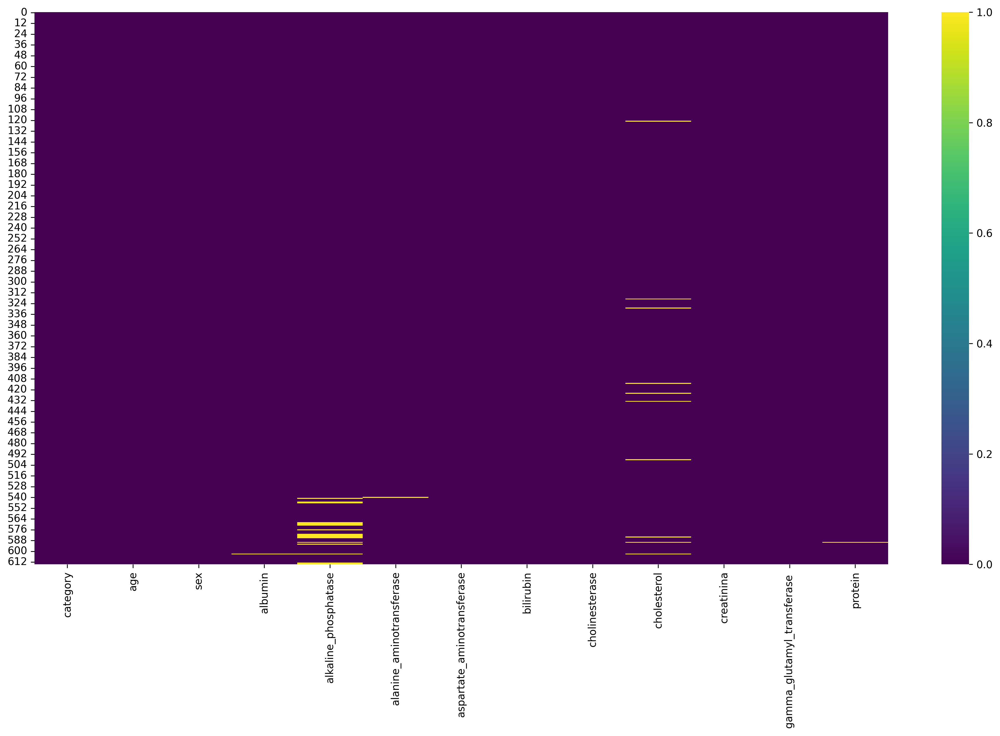

In [ ]:
sns.heatmap(df.isnull(),cmap="viridis")
plt.tight_layout()

in the dataset the columns such as albumin, alkaline_phosphatase, alanine_aminotransferase, cholesterol and protein contains missing values

to replace the missing values check for outliers

Since the columns are numerical


*   if outliers are present replace the missing values with the median
*   otherwise replace the missing values with the mean





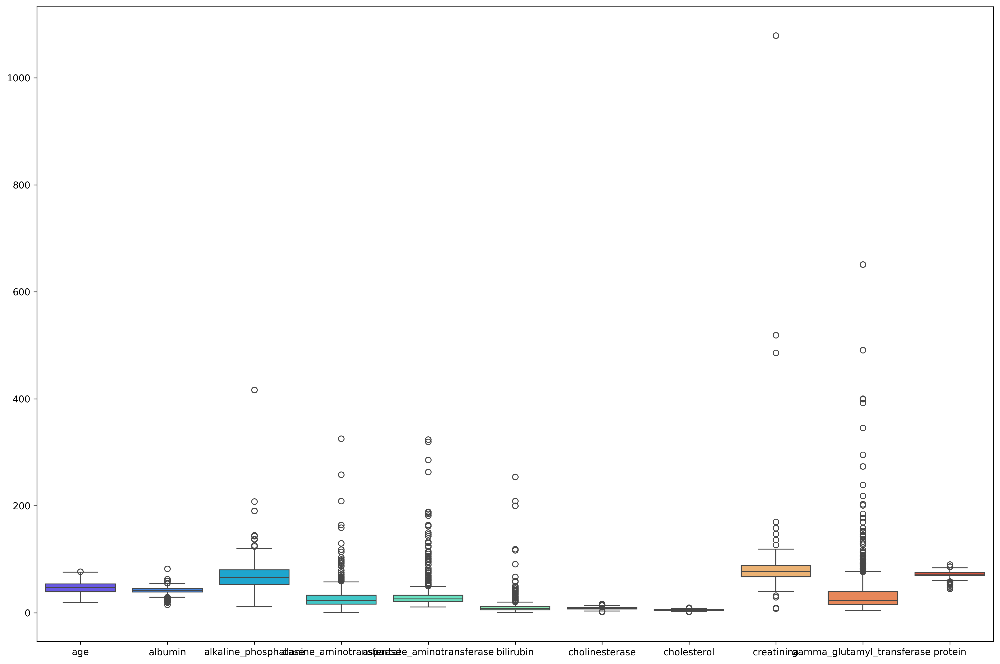

In [ ]:
sns.boxplot(df,palette="rainbow")
plt.tight_layout()

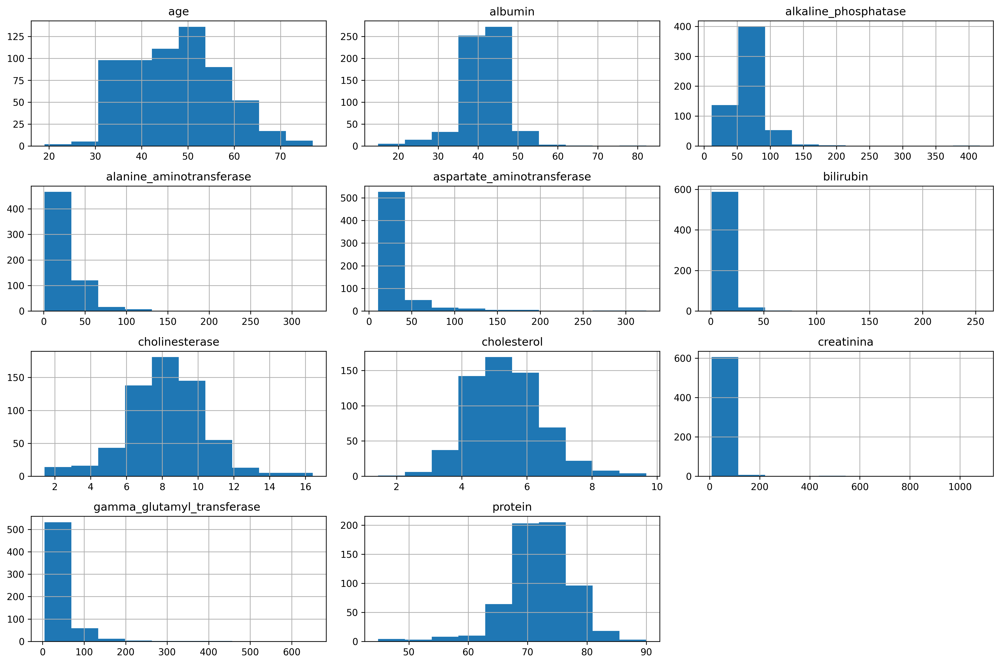

In [ ]:
df.hist()
plt.tight_layout()

In [ ]:

for i in df.isna().sum():
  print(i/len(df)*100)

0.0
0.0
0.0
0.16260162601626016
2.9268292682926833
0.16260162601626016
0.0
0.0
0.0
1.6260162601626018
0.0
0.0
0.16260162601626016


In [ ]:
df["albumin"].median()

41.95

In [ ]:
df["albumin"].fillna(df["albumin"].median(),inplace=True)

In [ ]:
df["alkaline_phosphatase"].median()


66.2

In [ ]:
df["alkaline_phosphatase"].fillna(df["alkaline_phosphatase"].median(),inplace=True)

In [ ]:
df["alanine_aminotransferase"].median()

23.0

In [ ]:
df["alanine_aminotransferase"].fillna(df["alanine_aminotransferase"].median(),inplace=True)

In [ ]:
df["cholesterol"].median()

5.3

In [ ]:
df["cholesterol"].fillna(df["cholesterol"].median(),inplace=True)

In [ ]:
df["protein"].median()

72.2

In [ ]:
df["protein"].fillna(df["protein"].median(),inplace=True)

In [ ]:
df.isnull().sum()

,0
category,0
age,0
sex,0
albumin,0
alkaline_phosphatase,0
alanine_aminotransferase,0
aspartate_aminotransferase,0
bilirubin,0
cholinesterase,0
cholesterol,0


There are 2 categorical columns in the Data set, Convert them into numerical

In [ ]:
df["sex"].value_counts()

,count
sex,
m,377
f,238


In [ ]:
df['sex'] = df['sex'].map({'f': 0, 'm': 1})

In [ ]:
df["category"].value_counts()

,count
category,
no_disease,533
cirrhosis,30
hepatitis,24
fibrosis,21
suspect_disease,7


In [ ]:
le=LabelEncoder()
df["category"]=le.fit_transform(df["category"])

In [ ]:
df

,category,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
0,3,32,1,38.5,52.5,7.7,22.1,7.5,6.93,3.23,106.0,12.1,69.0
1,3,32,1,38.5,70.3,18.0,24.7,3.9,11.17,4.80,74.0,15.6,76.5
2,3,32,1,46.9,74.7,36.2,52.6,6.1,8.84,5.20,86.0,33.2,79.3
3,3,32,1,43.2,52.0,30.6,22.6,18.9,7.33,4.74,80.0,33.8,75.7
4,3,32,1,39.2,74.1,32.6,24.8,9.6,9.15,4.32,76.0,29.9,68.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...
610,0,62,0,32.0,416.6,5.9,110.3,50.0,5.57,6.30,55.7,650.9,68.5
611,0,64,0,24.0,102.8,2.9,44.4,20.0,1.54,3.02,63.0,35.9,71.3
612,0,64,0,29.0,87.3,3.5,99.0,48.0,1.66,3.63,66.7,64.2,82.0
613,0,46,0,33.0,66.2,39.0,62.0,20.0,3.56,4.20,52.0,50.0,71.0


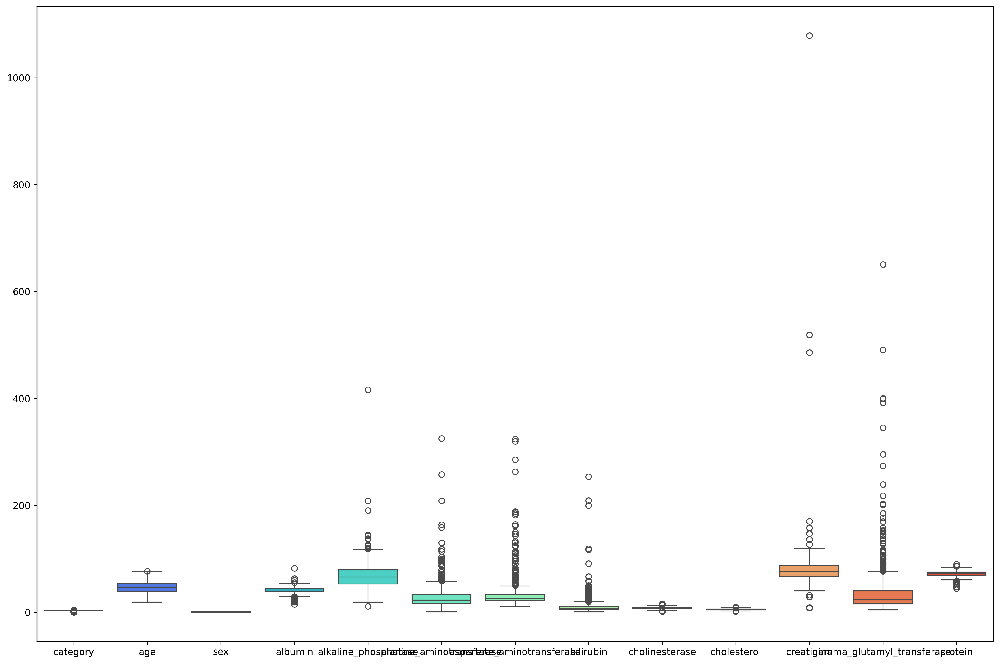

In [ ]:
sns.boxplot(df,palette="rainbow")
plt.tight_layout()

In [ ]:
# to treat the outliers
#capping replacing outlier values is called capping
#In capping all outlier values will be replaced by upper extreame or lower extreame
#Outliesr detection : user defined function to calculate upper extreame and lower extreame
def outlier_detection(data,colname):
  q1=data[colname].quantile(0.25)
  q2=data[colname].quantile(0.75)

  iqr=q2-q1
  upper_extreame=q2+(1.5*iqr)
  lower_extreame=q1-(1.5*iqr)
  return lower_extreame,upper_extreame,q1,q2


In [ ]:
outlier_detection(df,"category")

(3.0, 3.0, 3.0, 3.0)

In [ ]:
outlier_detection(df,"age")

(16.5, 76.5, 39.0, 54.0)

In [ ]:
outlier_detection(df,"albumin")

(29.19999999999999, 54.80000000000001, 38.8, 45.2)

In [ ]:
outlier_detection(df,"alkaline_phosphatase")

(13.425000000000011, 118.82499999999999, 52.95, 79.3)

In [ ]:
outlier_detection(df,"alanine_aminotransferase")

(-8.575, 58.02499999999999, 16.4, 33.05)

In [ ]:
outlier_detection(df,"aspartate_aminotransferase")

(4.650000000000006, 49.849999999999994, 21.6, 32.9)

In [ ]:
outlier_detection(df,"bilirubin")

(-3.55, 20.049999999999997, 5.3, 11.2)

In [ ]:
outlier_detection(df,"cholinesterase")

(2.9525000000000015, 13.572499999999998, 6.9350000000000005, 9.59)

In [ ]:
outlier_detection(df,"cholesterol")

(2.4675000000000007, 8.2075, 4.62, 6.055)

In [ ]:
outlier_detection(df,"creatinina")

(35.5, 119.5, 67.0, 88.0)

In [ ]:
outlier_detection(df,"gamma_glutamyl_transferase ")

(-21.050000000000008, 76.95000000000002, 15.7, 40.2)

In [ ]:
outlier_detection(df,"protein")

(60.149999999999984, 84.55000000000001, 69.3, 75.4)

In [ ]:
df.loc[df["category"]>3.0,"category"]=3.0

df.loc[df["age"]>76.5,"age"]=76.5

df.loc[df["albumin"]>54.8,"albumin"]=54.8
df.loc[df["albumin"]<29.199,"albumin"]=29.199

df.loc[df["alkaline_phosphatase"]>118.824,"alkaline_phosphatase"]=118.824
df.loc[df["alkaline_phosphatase"]<13.425,"alkaline_phosphatase"]=13.425

df.loc[df["alanine_aminotransferase"]>58.0249,"alanine_aminotransferase"]=58.0249

df.loc[df["aspartate_aminotransferase"]>49.849,"aspartate_aminotransferase"]=49.849

df.loc[df["bilirubin"]>20.049,"bilirubin"]=20.049

df.loc[df["cholinesterase"]>13.5724,"cholinesterase"]=13.5724
df.loc[df["cholinesterase"]<2.9525,"cholinesterase"]=2.9525

df.loc[df["cholesterol"]>8.2075,"cholesterol"]=8.2075
df.loc[df["cholesterol"]<2.4675,"cholesterol"]=2.4675

df.loc[df["creatinina"]>119.5,"creatinina"]=119.5
df.loc[df["creatinina"]<35.5,"creatinina"]=35.5

df.loc[df["gamma_glutamyl_transferase "]>76.950,"gamma_glutamyl_transferase "]=76.950

df.loc[df["protein"]>84.550,"protein"]=84.550
df.loc[df["protein"]<60.149,"protein"]=60.149

In [ ]:
df

,category,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
0,3,32.0,1,38.500,52.500,7.7000,22.100,7.500,6.9300,3.23,106.0,12.10,69.0
1,3,32.0,1,38.500,70.300,18.0000,24.700,3.900,11.1700,4.80,74.0,15.60,76.5
2,3,32.0,1,46.900,74.700,36.2000,49.849,6.100,8.8400,5.20,86.0,33.20,79.3
3,3,32.0,1,43.200,52.000,30.6000,22.600,18.900,7.3300,4.74,80.0,33.80,75.7
4,3,32.0,1,39.200,74.100,32.6000,24.800,9.600,9.1500,4.32,76.0,29.90,68.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...
610,0,62.0,0,32.000,118.824,5.9000,49.849,20.049,5.5700,6.30,55.7,76.95,68.5
611,0,64.0,0,29.199,102.800,2.9000,44.400,20.000,2.9525,3.02,63.0,35.90,71.3
612,0,64.0,0,29.199,87.300,3.5000,49.849,20.049,2.9525,3.63,66.7,64.20,82.0
613,0,46.0,0,33.000,66.200,39.0000,49.849,20.000,3.5600,4.20,52.0,50.00,71.0


In [ ]:
df["category"].value_counts()

,count
category,
3,540
0,30
2,24
1,21


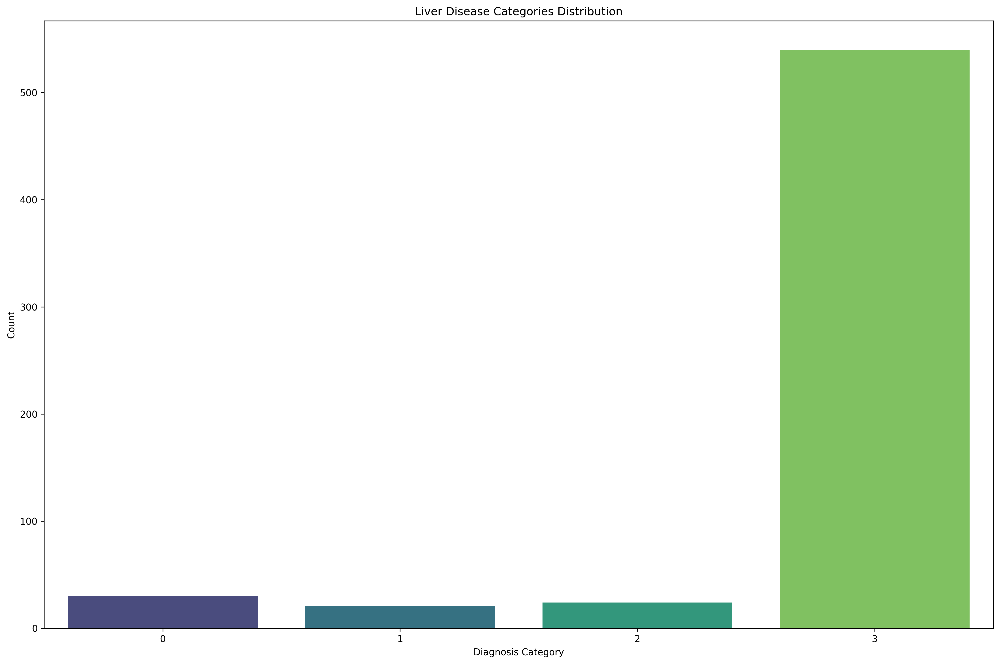

In [ ]:
sns.countplot(x='category', data=df,palette="viridis")
plt.title('Liver Disease Categories Distribution')
plt.xlabel('Diagnosis Category')
plt.ylabel('Count')
plt.tight_layout()
plt.show()

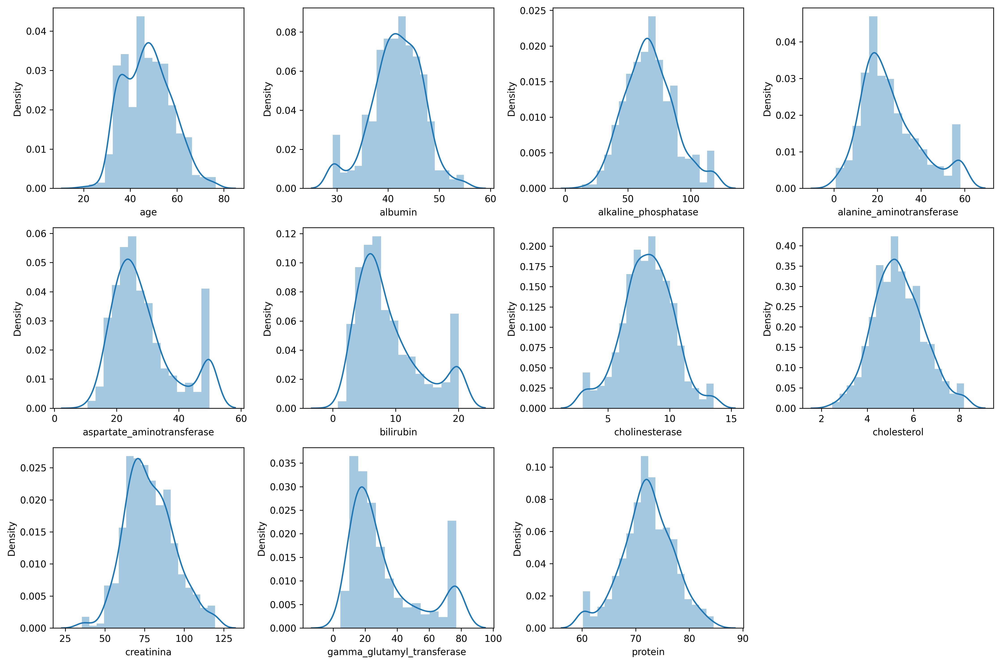

In [ ]:
plt.subplot(3,4,1)
sns.distplot(df["age"])
plt.tight_layout()

plt.subplot(3,4,2)
sns.distplot(df["albumin"])
plt.tight_layout()

plt.subplot(3,4,3)
sns.distplot(df["alkaline_phosphatase"])
plt.tight_layout()

plt.subplot(3,4,4)
sns.distplot(df["alanine_aminotransferase"])
plt.tight_layout()

plt.subplot(3,4,5)
sns.distplot(df["aspartate_aminotransferase"])
plt.tight_layout()

plt.subplot(3,4,6)
sns.distplot(df["bilirubin"])
plt.tight_layout()

plt.subplot(3,4,7)
sns.distplot(df["cholinesterase"])
plt.tight_layout()

plt.subplot(3,4,8)
sns.distplot(df["cholesterol"])
plt.tight_layout()

plt.subplot(3,4,9)
sns.distplot(df["creatinina"])
plt.tight_layout()

plt.subplot(3,4,10)
sns.distplot(df["gamma_glutamyl_transferase "])
plt.tight_layout()

plt.subplot(3,4,11)
sns.distplot(df["protein"])
plt.tight_layout()




In [ ]:
df.describe()

,category,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
count,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000
mean,2.746341,47.407317,0.613008,41.702972,67.283963,25.860157,28.668026,8.879354,8.202307,5.358667,78.356748,31.590163,72.203550
std,0.742420,10.052729,0.487458,4.987454,19.779320,13.500299,9.938202,5.028420,2.079426,1.087706,15.363140,21.591212,4.788479
min,0.000000,19.000000,0.000000,29.199000,13.425000,0.900000,10.600000,0.800000,2.952500,2.467500,35.500000,4.500000,60.149000
25%,3.000000,39.000000,0.000000,38.800000,52.950000,16.400000,21.600000,5.300000,6.935000,4.620000,67.000000,15.700000,69.300000
50%,3.000000,47.000000,1.000000,41.950000,66.200000,23.000000,25.900000,7.300000,8.260000,5.300000,77.000000,23.300000,72.200000
75%,3.000000,54.000000,1.000000,45.200000,79.300000,33.050000,32.900000,11.200000,9.590000,6.055000,88.000000,40.200000,75.400000
max,3.000000,76.500000,1.000000,54.800000,118.824000,58.024900,49.849000,20.049000,13.572400,8.207500,119.500000,76.950000,84.550000


In [ ]:
sns.pairplot(df,hue="category",palette="rainbow")
plt.tight_layout()

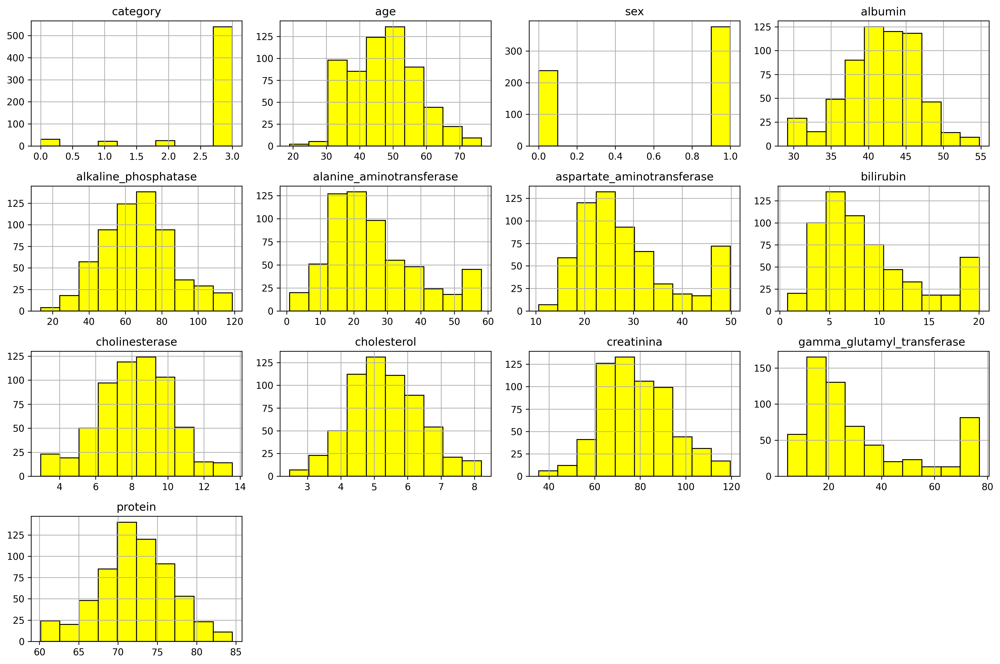

In [ ]:
df.hist(color="yellow",edgecolor="black")
plt.tight_layout()


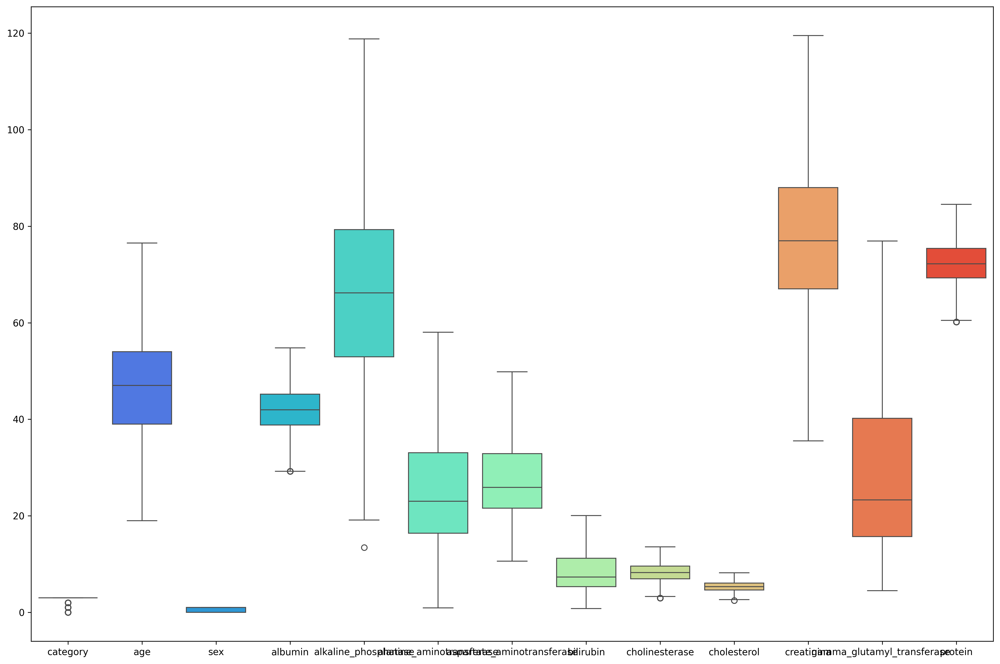

In [ ]:
sns.boxplot(df,palette="rainbow")
plt.tight_layout()

Text(437.0416666666667, 0.5, 'COUNT')

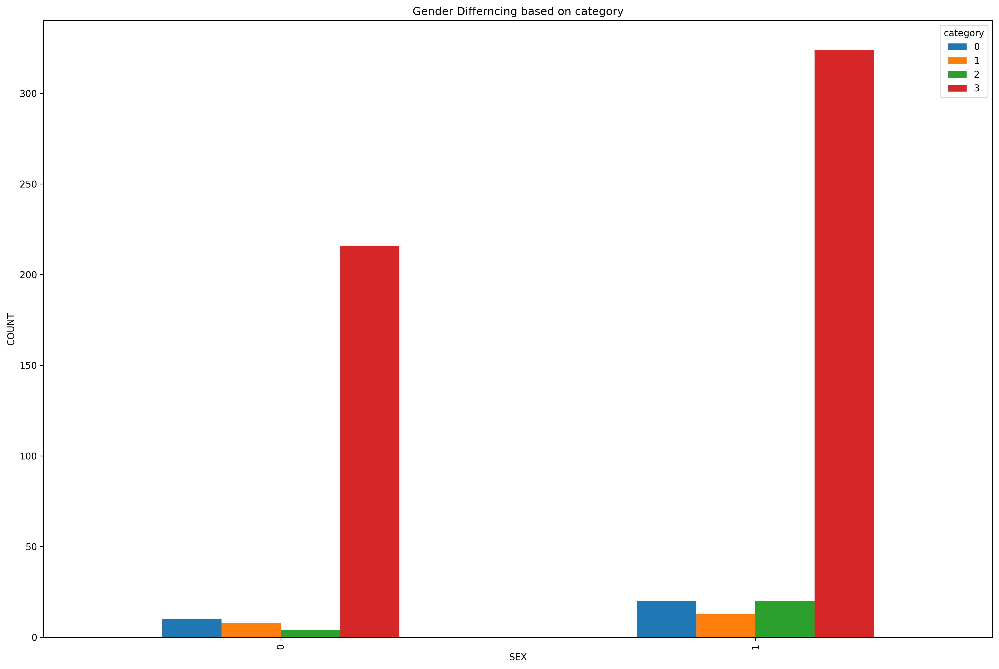

In [ ]:
pd.crosstab(df["sex"],df["category"]).plot(kind="bar")
plt.tight_layout()
plt.title("Gender Differncing based on category")
plt.xlabel("SEX")
plt.ylabel("COUNT")

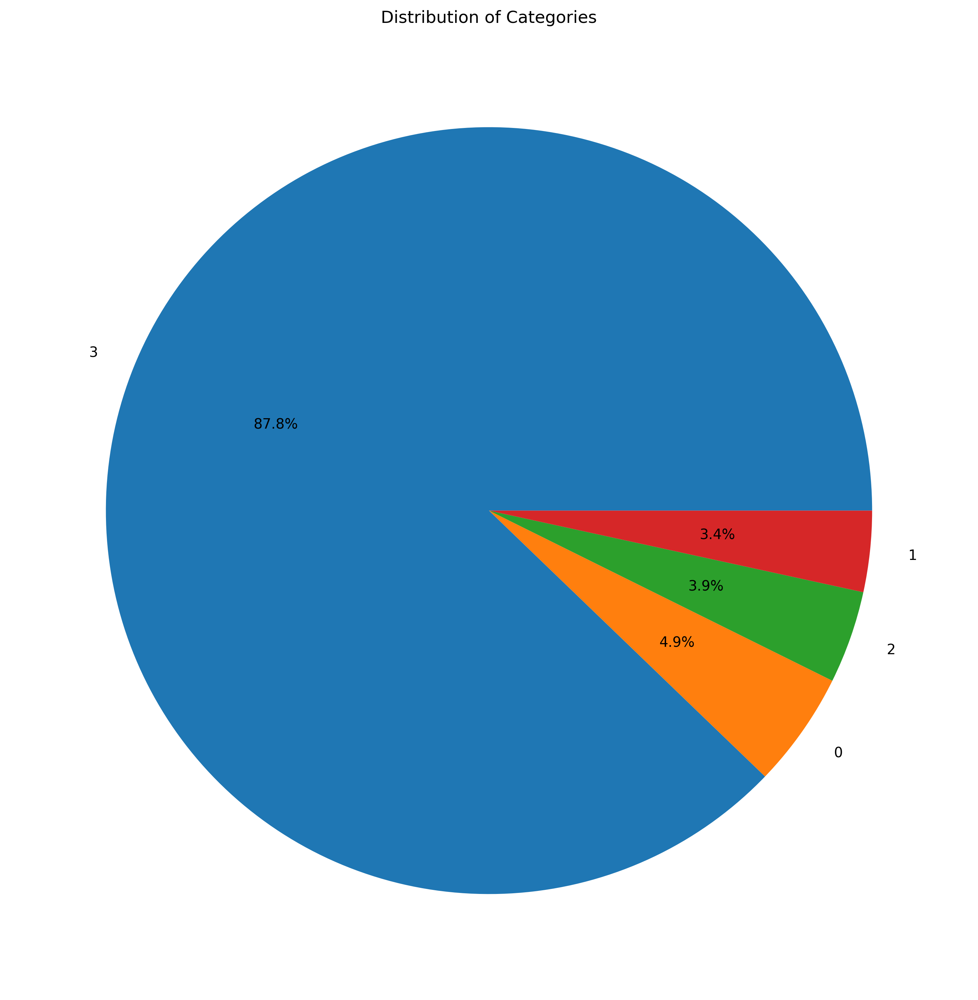

In [ ]:
category_counts = df['category'].value_counts()
plt.pie(category_counts, labels=category_counts.index, autopct='%1.1f%%')
plt.title('Distribution of Categories')
plt.tight_layout()
plt.show()

Text(276.04166666666663, 0.5, 'ALBUMIN')

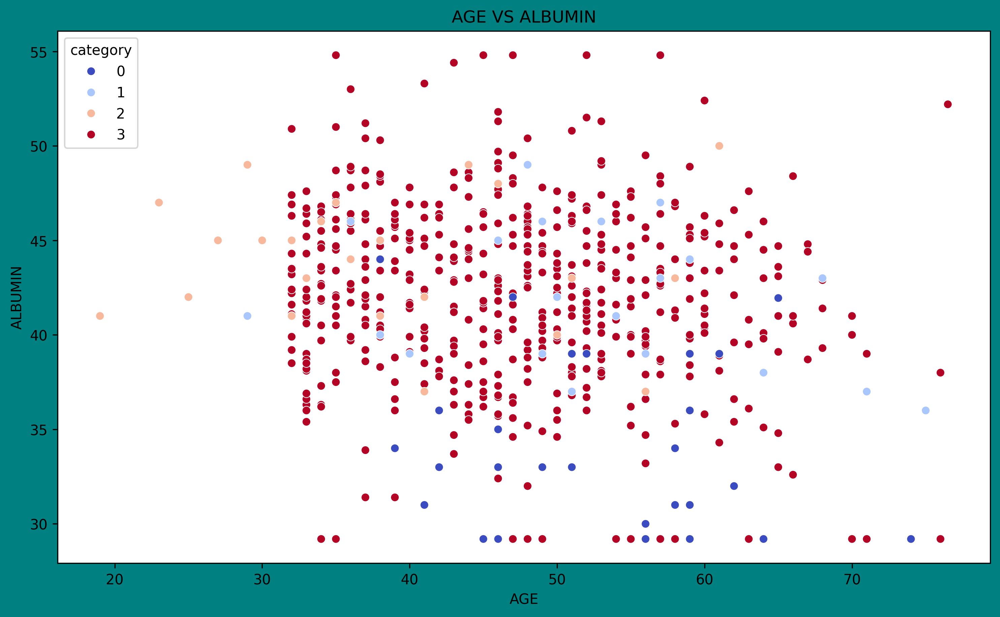

In [ ]:
plt.figure(figsize=(10,6),facecolor='teal',edgecolor="red",)
sns.scatterplot(x="age",y="albumin",data=df,hue="category",palette="coolwarm")
plt.tight_layout()
plt.title("AGE VS ALBUMIN")
plt.xlabel("AGE")
plt.ylabel("ALBUMIN")

{'bodies': [<matplotlib.collections.PolyCollection at 0x794b83dfb130>,
 'cmaxes': <matplotlib.collections.LineCollection at 0x794b83d8d6f0>,
 'cmins': <matplotlib.collections.LineCollection at 0x794b83e2d8a0>,
 'cbars': <matplotlib.collections.LineCollection at 0x794b83e2de40>}

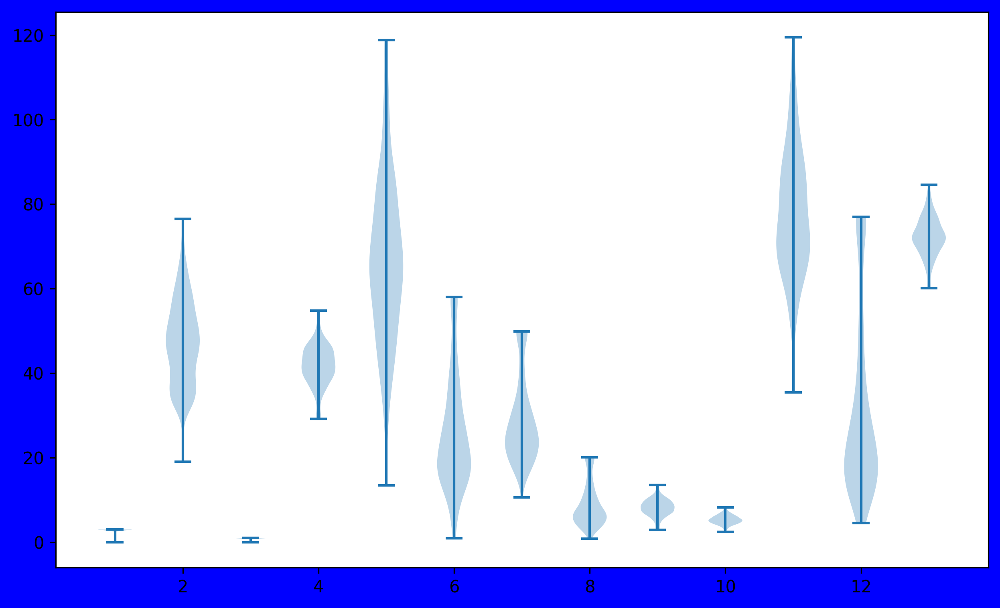

In [ ]:
plt.figure(figsize=(10,6),facecolor="blue",frameon=True)
plt.violinplot(df)

<Axes: xlabel='sex', ylabel='cholesterol'>

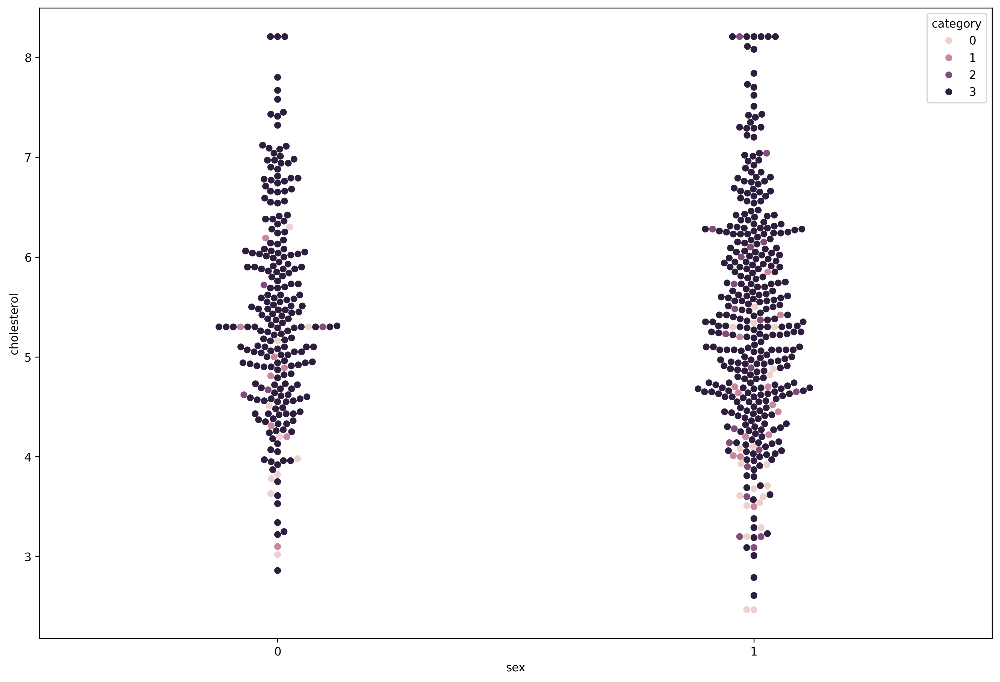

In [ ]:
sns.swarmplot(x="sex",y="cholesterol",data=df,size=6,hue="category")

In [ ]:
df.corr()

,category,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
category,1.000000,-0.118594,-0.046672,0.287238,0.071241,0.086246,-0.608012,-0.441002,0.337252,0.300064,0.041717,-0.451409,-0.031764
age,-0.118594,1.000000,-0.024614,-0.192789,0.173501,-0.071437,0.072680,0.020183,-0.072111,0.132178,-0.029495,0.121822,-0.136548
sex,-0.046672,-0.024614,1.000000,0.174722,0.020497,0.278055,0.259172,0.240163,0.175220,-0.032529,0.456095,0.246982,0.068344
albumin,0.287238,-0.192789,0.174722,1.000000,-0.089634,0.160967,-0.089545,0.015635,0.383444,0.189071,0.230132,-0.056316,0.531445
alkaline_phosphatase,0.071241,0.173501,0.020497,-0.089634,1.000000,0.172881,-0.003834,-0.082244,0.093550,0.144713,0.056884,0.150933,-0.005844
alanine_aminotransferase,0.086246,-0.071437,0.278055,0.160967,0.172881,1.000000,0.426771,0.088192,0.283943,0.161518,0.205540,0.391095,0.200929
aspartate_aminotransferase,-0.608012,0.072680,0.259172,-0.089545,-0.003834,0.426771,1.000000,0.385566,-0.037922,-0.149155,0.067374,0.526642,0.121445
bilirubin,-0.441002,0.020183,0.240163,0.015635,-0.082244,0.088192,0.385566,1.000000,-0.157143,-0.171959,0.177179,0.241094,0.118292
cholinesterase,0.337252,-0.072111,0.175220,0.383444,0.093550,0.283943,-0.037922,-0.157143,1.000000,0.422415,0.146900,0.028232,0.294747
cholesterol,0.300064,0.132178,-0.032529,0.189071,0.144713,0.161518,-0.149155,-0.171959,0.422415,1.000000,0.043333,0.043038,0.177445


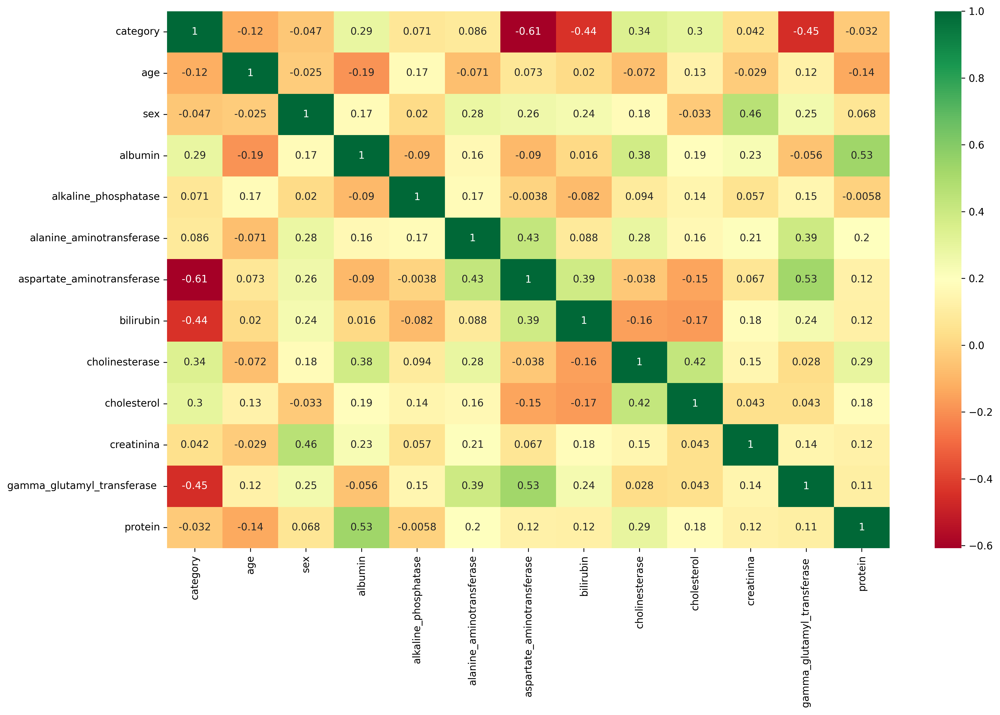

In [ ]:
sns.heatmap(df.corr(),annot=True,cmap="RdYlGn")
plt.tight_layout()

In [ ]:
x=df.drop("category",axis=1)
y=df["category"]

In [ ]:
# standardization

sc=StandardScaler()
x1=sc.fit_transform(x)

In [ ]:
x=pd.DataFrame(x1,columns=x.columns)
x

,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
0,-1.533898,0.794544,-0.642729,-0.748054,-1.346262,-0.661425,-0.274535,-0.612353,-1.958618,1.800788,-0.903424,-0.669557
1,-1.533898,0.794544,-0.642729,0.152609,-0.582695,-0.399595,-0.991048,1.428331,-0.514037,-0.283815,-0.741189,0.897978
2,-1.533898,0.794544,1.042868,0.375244,0.766521,2.133003,-0.553179,0.306917,-0.145992,0.497911,0.074621,1.483191
3,-1.533898,0.794544,0.300403,-0.773353,0.351378,-0.611073,1.994424,-0.419836,-0.569244,0.107048,0.102432,0.730774
4,-1.533898,0.794544,-0.502262,0.344885,0.499643,-0.389525,0.143431,0.456118,-0.955693,-0.153528,-0.078344,-0.732258
...,...,...,...,...,...,...,...,...,...,...,...,...
610,1.452796,-1.258584,-1.947059,2.607875,-1.479701,2.133003,2.223111,-1.266912,0.866135,-1.475948,2.102557,-0.774059
611,1.651909,-1.258584,-2.509126,1.797076,-1.702099,1.584268,2.213359,-2.526698,-2.151842,-1.000398,0.199773,-0.188846
612,1.651909,-1.258584,-2.509126,1.012792,-1.657619,2.133003,2.223111,-2.526698,-1.590572,-0.759365,1.511559,2.047503
613,-0.140107,-1.258584,-1.746393,-0.054847,0.974092,2.133003,2.213359,-2.234312,-1.066106,-1.716980,0.853348,-0.251547


In [ ]:
y # target column

,category
0,3
1,3
2,3
3,3
4,3
...,...
610,0
611,0
612,0
613,0


## **MODEL BUILDING**

In [ ]:
# splitting the dataset into training(77%) and testing(33%)data
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.33,random_state=42)

In [ ]:
x_train

,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
547,-1.533898,0.794544,0.661602,-1.653776,1.366996,2.133003,1.417233,0.918160,0.847732,0.185220,0.765278,2.068403
327,-1.434341,-1.258584,-0.702928,-0.651916,-0.634588,-0.752058,-0.354148,0.225097,0.304865,-0.674678,0.023632,-1.108466
496,0.855457,-1.258584,0.681669,0.597880,0.974092,0.184487,-0.732307,-0.833748,-0.238003,-0.935254,2.102557,-1.150267
380,-0.438777,-1.258584,0.481003,-1.309703,-0.612348,-0.893043,-0.294438,-0.328390,0.636106,-0.609535,-0.476978,0.208263
412,-0.140107,-1.258584,-0.361796,0.334765,-0.879226,-1.154873,1.476942,-0.612353,-0.228802,-0.479247,-0.875613,-1.568276
...,...,...,...,...,...,...,...,...,...,...,...,...
71,-0.936559,0.794544,-0.361796,-0.221824,2.384460,1.533917,0.302656,1.298382,1.519416,1.344781,2.102557,0.187362
106,-0.637890,0.794544,0.601402,0.385364,-0.048939,-0.852762,-0.513373,1.028857,-1.038503,-0.283815,-0.365731,-0.021642
270,1.154126,0.794544,-0.381862,-0.904911,-0.034113,-0.731917,2.223111,-0.338016,-1.535365,0.497911,-0.597496,-0.063443
435,0.059005,-1.258584,0.541203,-0.748054,-0.701307,-0.530510,-0.871629,0.412802,1.307790,-0.283815,-0.986860,0.187362


In [ ]:
x_test

,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
248,0.755901,0.794544,-2.509126,-0.090267,-0.686481,-1.124662,-1.209983,-1.262099,-0.891285,-0.870110,-0.249849,-2.048987
365,-0.837003,-1.258584,-2.067459,1.958993,-0.686481,-1.175014,-1.289596,-1.084021,-0.053980,-0.674678,-0.402814,0.020159
432,0.059005,-1.258584,0.400736,-0.869492,-0.634588,-0.238469,-0.155116,-0.025175,0.019629,-0.935254,-0.843166,0.187362
610,1.452796,-1.258584,-1.947059,2.607875,-1.479701,2.133003,2.223111,-1.266912,0.866135,-1.475948,2.102557,-0.774059
132,-0.339220,0.794544,-1.244727,0.729437,0.121566,0.083783,-0.493470,0.292479,1.188175,0.302479,-0.347190,-0.878561
...,...,...,...,...,...,...,...,...,...,...,...,...
108,-0.538333,0.794544,0.721802,-0.606377,0.381031,2.133003,1.914811,2.584590,0.479687,0.302479,-0.750460,0.041059
416,-0.140107,-1.258584,-0.763128,-0.393861,0.529296,-0.369384,-1.030855,-1.031078,-0.053980,0.888774,0.570596,-0.460552
195,0.258118,0.794544,0.982668,-0.049788,-0.471496,-0.500299,1.914811,0.032580,0.341669,0.888774,-0.903424,0.939779
614,1.154126,-1.258584,-1.144394,-0.054847,2.384460,2.133003,0.621107,0.417615,-0.053980,-0.739822,0.111703,-0.878561


In [ ]:
y_train

,category
547,2
327,3
496,3
380,3
412,3
...,...
71,3
106,3
270,3
435,3


In [ ]:
y_test

,category
248,3
365,3
432,3
610,0
132,3
...,...
108,3
416,3
195,3
614,0


### ***XGBM***

In [ ]:
params={
    'n_estimators':[90,110,150],
    'learning_rate':[0.5,0.7,1],
    'lambda':[1,2,3],
    'max_depth':[3,7,11]
}

In [ ]:
grid=GridSearchCV(XGBClassifier(),param_grid=params,verbose=1)
grid.fit(x_train,y_train)

Fitting 5 folds for each of 81 candidates, totalling 405 fits


GridSearchCV(estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     feature_types=None, gamma=None,
                                     grow_policy=None, importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None, max_b...
                                     max_cat_threshold=None,
                                     max_cat_to_onehot=None,
                                     max_delta_step=None, max_depth=None,
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None,
                                     random_state=None, ...),
             param_grid={'lambda': [1, 2, 3], 'learning_rate': [0.5, 0.7, 1],
                         'max_depth': [3, 7, 11],
                         'n_estimators': [90, 110, 150]},
             verbose=1)

In [ ]:
grid.best_params_

{'lambda': 1, 'learning_rate': 0.5, 'max_depth': 7, 'n_estimators': 110}

In [ ]:
model5 = XGBClassifier(reg_lambda=1,learning_rate=0.5,max_depth=7,n_estimators=110)
model5.fit(x_train,y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.5, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=7, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=110, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [ ]:
y_predict5=model5.predict(x_test)
y_predict5

array([3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3,
       0, 3, 2, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3,
       3, 0, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 1, 3, 3,
       3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3,
       3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 2, 3, 1, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 1, 3])

In [ ]:
y_test.values

array([3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3,
       0, 3, 2, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3,
       3, 2, 3, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 3, 3, 3, 1, 3, 1,
       3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 3, 3, 3,
       3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 2, 2, 3, 2, 3, 3, 3, 3,
       3, 3, 3, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 1, 3, 3, 3, 3,
       3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 0, 3])

In [ ]:
print('train accuracy:',model5.score(x_train,y_train))
print('test accuracy:',model5.score(x_test,y_test))

train accuracy: 1.0
test accuracy: 0.9211822660098522


In [ ]:
class_report5=classification_report(y_test,y_predict5)
print(class_report5)

              precision    recall  f1-score   support

           0       0.89      0.67      0.76        12
           1       0.33      0.38      0.35         8
           2       0.80      0.36      0.50        11
           3       0.96      1.00      0.98       172

    accuracy                           0.92       203
   macro avg       0.74      0.60      0.65       203
weighted avg       0.92      0.92      0.91       203

